In [1]:
using Plots
using Printf
using LinearAlgebra

In [6]:
function rk4(z,n_rk_steps,step_size)
    """ A non-symplectic fourth-order accurate Runge-Kutta """
    dphi        = step_size
    phi_current = 0.0
    z_current   = 1.0*z
    z_hist      = [Float64[0,0] for j=1:n_rk_steps+1]
    z_hist[1]   = 1.0*z_current
    for i in 1:n_rk_steps
        k1 = zdot_osc(z_current,phi_current)
        k2 = zdot_osc(z_current + .5*dphi*k1, phi_current + .5*dphi)
        k3 = zdot_osc(z_current + .5*dphi*k2, phi_current + .5*dphi)
        k4 = zdot_osc(z_current + dphi * k3, phi_current + dphi)
        z_current   = z_current + (1.0/6.0) * dphi * (k1 + 2*k2 + 2*k3 + k4)
        z_hist[i+1] = z_current 
        phi_current = phi_current + dphi
    end
    return z_hist
end

function rk2(z,n_rk_steps,step_size)
    """ A non-symplectic second-order accurate Runge-Kutta """
    dphi        = step_size
    phi_current = 0.0
    z_current   = 1.0*z
    z_hist      = [Float64[0,0] for j=1:n_rk_steps+1]
    z_hist[1]   = 1.0*z_current
    for i in 1:n_rk_steps
        k1 = zdot_osc(z_current,phi_current)
        k2 = zdot_osc(z_current + dphi*k1, phi_current + dphi)
        z_current   = z_current + 0.5 * dphi * (k1 + k2)
        z_hist[i+1] = z_current 
        phi_current = phi_current + dphi
    end
    return z_hist
end

function leapfrog(z,n_lf_steps,step_size)
    """ A symplectic second-order accurate Verlet integrator """
    dphi      = step_size
    phi_current = 0.0
    z_current = 1.0*z
    q_new     = 1.0*z[1]
    z_hist      = [Float64[0,0] for j=1:n_lf_steps+1]
    z_hist[1]   = 1.0*z_current
    for i in 1:n_lf_steps
        xnew         = z_current[1] + dphi * z_current[2] + 0.5 * dphi^2 * (-z_current[1])
        vnew         = z_current[2] + 0.5 * dphi * -(z_current[1] + xnew)
        z_current    = [xnew,vnew]
        z_hist[i+1][1]  = z_current[1]
        z_hist[i+1][2]  = z_current[2]
        phi_current  = phi_current + dphi
    end
    return z_hist
end


function zdot_osc(z,t)
    """ Equations of motion for the Hamiltonian H(x,p) = p^2/2 + x^2/2 """
    X = z[1]
    P = z[2]
    return [-P,X]
end

zdot_osc (generic function with 1 method)

In [8]:
"Define our initial conditions and time steps, etc."
step_size  = 1.0/32.0
n_rk_steps = n_lf_steps = 100
phi        = 0:step_size:n_rk_steps*step_size # range over time-steps
x0         = 1.0
p0         = 0.0
z          = [x0,p0] # initial conditions (IC)

z_hist=leapfrog(z,n_lf_steps,step_size) 
x_lf = [z_hist[i][1] for i =1:length(z_hist)]
#plot(phi,x_lf,label="LF")

#k = pi^2
#H_osc(x,p) = (p^2/2) + (k*x^2/2) # Hamiltonian
#q1(t)       = x0*cos.(pi*t) - p0*sin.(pi*t) # Exact solution for position
#p(t)       = x0*sin.(pi*t) + p0*cos.(pi*t) # Exact solution for momentum (= velocity in this case)
#z_hist_ex   = [[q1(t),p(t)] for t in phi] 
#x_ex = [z_hist_ex[i][1] for i =1:length(z_hist_ex)]
#plot!(phi,x_ex,label="LF")

print(z_hist)

[[1.0, 0.0], [0.99951171875, -0.03124237060546875], [0.9980473518371582, -0.0624542310833931], [0.9956083293072879, -0.09360510110127507], [0.9921970330183285, -0.12466455988761282], [0.9878167943143121, -0.15560227593968534], [0.9824718907720982, -0.1863880366441605], [0.9761675420240521, -0.21699177778160036], [0.9689099046607481, -0.24738361288605037], [0.9607060662186739, -0.27753386243104133], [0.9515640382588081, -0.307413082813502], [0.9414927485428302, -0.33699209510727757], [0.9305020323146033, -0.366242013558175], [0.9186026226954442, -0.395134273792707], [0.9058061402025591, -0.4236406607129883], [0.8921250814008825, -0.45173333605054206], [0.8775728066994003, -0.47938486555210896], [0.8621635273038757, -0.5065682457709102], [0.8459122913387184, -0.5332569304372007], [0.8288349691515506, -0.5594248563823612], [0.8109482378148208, -0.5850464689912107], [0.7922695648396, -0.610096747157686], [0.7728171911174654, -0.6345512277195152], [0.7526101131071302, -0.6583860293480245], 

## We would expect a plot of the total energy (H) vs time to show that the energy of the system is approximately conserved. 

In [80]:
"Define our initial conditions and time steps, etc."
step_size  = 0.02*2*pi
n_rk_steps = n_lf_steps =50*1
phi        = 0:step_size:n_rk_steps*step_size # range over time-steps
x0         = 1.0
p0         = 0.0
z          = [x0,p0] # initial conditions (IC)
"Define our Hamiltonian for a simple harmonic osc. and the exact solutions"
H_osc(x,p) = (p^2/2) + (x^2/2) # Hamiltonian
q(t)       = x0*cos.(t) - p0*sin.(t) # Exact solution for position
p(t)       = x0*sin.(t) + p0*cos.(t) # Exact solution for momentum (= velocity in this case)
"Compute the exact and numerical solutions"
phi2        = 0:0.2*2*pi:5*0.2*2*pi # range over time-steps
z_hist_check = [[q(t),p(t)] for t in phi2] 
z_hist_ex   = [[q(t),p(t)] for t in phi] 

z_lf_check  = leapfrog2(z,5,0.2*2*pi) # integrate from ICs using LF2
z_hist_lf   = leapfrog2(z,n_lf_steps,step_size) # integrate from ICs using LF2

z_hist_rk2  = rk2(z,n_rk_steps,step_size) # integrate from ICs using RK2
z_hist_rk4  = rk4(z,n_rk_steps,step_size) # integrate from ICs using RK4
@printf("Local error for LF = %0.5f\n", norm(z_hist_ex[20]-z_hist_lf[20]))
@printf("Local error for RK2 = %0.5f\n", norm(z_hist_ex[20]-z_hist_rk2[20]))
@printf("Local error for RK4 = %0.8f\n", norm(z_hist_ex[20]-z_hist_rk4[20]))
@printf("local second-order expected = %0.5f\n", step_size^3)
@printf("local fourth-order expected = %0.5f\n", step_size^5)
"Plot the numerical and exact solutions"
len    = length(z_hist_rk2)
E_ex   = [H_osc(z_hist_ex[i][1],z_hist_ex[i][2]) for i=1:len] # H vs time for RK
E_rk2  = [H_osc(z_hist_rk2[i][1],z_hist_rk2[i][2]) for i=1:len] # H vs time for RK2
E_rk4  = [H_osc(z_hist_rk4[i][1],z_hist_rk4[i][2]) for i=1:len] # H vs time for RK4
E_lf   = [H_osc(z_hist_lf[i][1],z_hist_lf[i][2]) for i=1:len] # H vs time for LF
@printf("Error in H for exact = %0.5f\n",norm(E_ex-0.5*ones(len)))
@printf("Error in H for LF = %0.5f\n", norm(E_lf-0.5*ones(len)))
@printf("Error in H for RK2 = %0.5f\n", norm(E_rk2-0.5*ones(len)))
@printf("Error in H for RK4 = %0.5f\n", norm(E_rk4-0.5*ones(len)))
plot(phi,2*E_rk2,label="RK2",)
plot!(phi,2*E_rk4,label="RK4",)
plot!(phi,2*E_ex,label="exact")
plot!(phi,2*E_lf,label="LF",xlabel="time",ylabel="H")
print(E_lf)

LoadError: cannot define function q; it already has a value

## The phase space plot for one orbit should be a circular trajectory. 

In [30]:
er_lf  = norm([z_hist_ex[i][1]-z_hist_lf[i][1] for i =len-50:len])
er_rk2 = norm([z_hist_ex[i][1]-z_hist_rk2[i][1] for i =len-50:len])
er_rk4 = norm([z_hist_ex[i][1]-z_hist_rk4[i][1] for i =len-50:len])
@printf("Global error for LF = %0.5f\n",  er_lf)
@printf("Global error for RK2 = %0.5f\n", er_rk2)
@printf("Global error for RK4 = %0.5f\n", er_rk4)
@printf("global second-order expected = %0.5f\n", step_size^2)
@printf("global fourth-order expected = %0.5f\n", step_size^4)
p_ex = [z_hist_ex[i][2] for i =len-50:len]
x_ex = [z_hist_ex[i][1] for i =len-50:len]
p_lf = [z_hist_lf[i][2] for i =len-50:len]
x_lf = [z_hist_lf[i][1] for i =len-50:len]
p_rk2 = [z_hist_rk2[i][2] for i =len-50:len]
x_rk2 = [z_hist_rk2[i][1] for i =len-50:len]
p_rk4 = [z_hist_rk4[i][2] for i =len-50:len]
x_rk4 = [z_hist_rk4[i][1] for i =len-50:len]
plot(phi,x_ex,seriestype = :scatter,label="exact",size = (700, 700))
plot!(phi,x_lf,seriestype = :scatter,label="LF",size = (700, 700))
#plot(x_ex,p_ex,seriestype = :scatter,label="exact",size = (700, 700))
#plot!(x_lf,p_lf,seriestype = :scatter,label="LF")
#plot!(x_rk2,p_rk2,seriestype = :scatter,label="RK2")
#plot!(x_rk4,p_rk4,seriestype = :scatter,label="RK4")
print(x_lf)

Global error for LF = 0.01172
Global error for RK2 = 0.04784
Global error for RK4 = 0.00004
global second-order expected = 0.01579
global fourth-order expected = 0.00025
[1.0, 0.9921043164791286, 0.9685419495530376, 0.9296849812062293, 0.8761470160879976, 0.8087734918561924, 0.7286283285608539, 0.6369771278921993, 0.5352671875998037, 0.42510464668261816, 0.3082291222585169, 0.18648623863187713, 0.06179848236276732, -0.06386515642395564, -0.18852027708440958, -0.31019840485461253, -0.4269780757579931, -0.5370151791483021, -0.6385720787376928, -0.730045052249128, -0.8099896163834887, -0.877143337185537, -0.9304457656018693, -0.9690551834211469, -0.9923618951553177, -0.9999978559648511, -0.9918424835898876, -0.9680245625089622, -0.9289202102560351, -0.875146938010462, -0.807553899251308, -0.7272084804630861, -0.6353794456440033, -0.5335169007879769, -0.42322939472863436, -0.3062585179542773, -0.18445140051324396, -0.05973154330534246, 0.06593155662686347, 0.19055350714874114, 0.3121663572

In [248]:
"Define our initial conditions and time steps, etc."
n_rk_steps = n_lf_steps = 50*10000
phi        = 0:step_size:n_rk_steps*step_size # range over time-steps
x0         = 1.0
p0         = 0.0
z          = [x0,p0] # initial conditions (IC)
"Define our Hamiltonian for a simple harmonic osc. and the exact solutions"
H_osc(x,p) = (p^2/2) + (x^2/2) # Hamiltonian
q(t)       = x0*cos.(t) - p0*sin.(t) # Exact solution for position
p(t)       = x0*sin.(t) + p0*cos.(t) # Exact solution for momentum (= velocity in this case)
"Compute the exact and numerical solutions"
z_hist_ex   = [[q(t),p(t)] for t in phi] 
z_hist_lf   = leapfrog2(z,n_lf_steps,step_size) # integrate from ICs using LF2
z_hist_rk2  = rk2(z,n_rk_steps,step_size) # integrate from ICs using RK2
z_hist_rk4  = rk4(z,n_rk_steps,step_size) # integrate from ICs using RK4
"Plot the numerical and exact solutions"
len    = length(z_hist_rk2)
E_ex   = [H_osc(z_hist_ex[i][1],z_hist_ex[i][2]) for i=1:len] # H vs time for RK
E_rk2  = [H_osc(z_hist_rk2[i][1],z_hist_rk2[i][2]) for i=1:len] # H vs time for RK2
E_rk4  = [H_osc(z_hist_rk4[i][1],z_hist_rk4[i][2]) for i=1:len] # H vs time for RK4
E_lf   = [H_osc(z_hist_lf[i][1],z_hist_lf[i][2]) for i=1:len] # H vs time for LF
@printf("Energy error for exact = %0.4f\n",norm(E_ex-0.5*ones(len)))
@printf("Energy error for LF = %0.4f\n", norm(E_lf-0.5*ones(len)))
#@printf("Max energy error for RK2 = %0.4f\n", norm(E_rk2-0.5*ones(len)))
@printf("Energy error for RK4 = %0.4f\n", norm(E_rk4-0.5*ones(len)))
#plot(phi,2*E_rk2,label="RK2",)
plot(phi,2*E_rk4,label="RK4",)
plot!(phi,2*E_ex,label="exact")
plot!(phi,2*E_lf,label="LF",xlabel="time",ylabel="H")

Energy error for exact = 0.0000
Energy error for LF = 0.8547
Energy error for RK4 = 5.5144


Global error for LF = 9.76905
Global error for RK4 = 0.64819


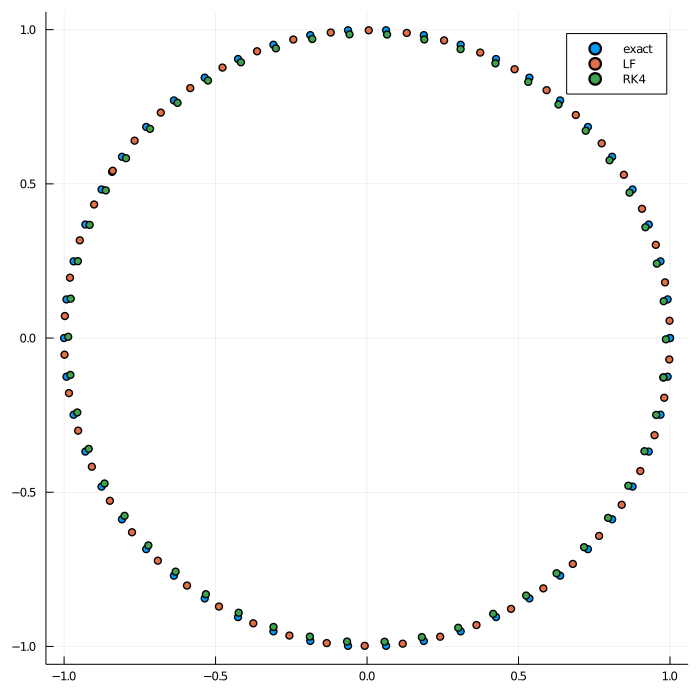

In [250]:
er_lf  = norm([z_hist_ex[i][1]-z_hist_lf[i][1]  for i =len-50:len])
er_rk2 = norm([z_hist_ex[i][1]-z_hist_rk2[i][1] for i =len-50:len])
er_rk4 = norm([z_hist_ex[i][1]-z_hist_rk4[i][1] for i =len-50:len])
@printf("Global error for LF = %0.5f\n",  er_lf)
#@printf("Max global error for RK2 = %0.5f\n", er_rk2)
@printf("Global error for RK4 = %0.5f\n", er_rk4)
p_ex = [z_hist_ex[i][2] for i =len-50:len]
x_ex = [z_hist_ex[i][1] for i =len-50:len]
p_lf = [z_hist_lf[i][2] for i =len-50:len]
x_lf = [z_hist_lf[i][1] for i =len-50:len]
p_rk2 = [z_hist_rk2[i][2] for i =len-50:len]
x_rk2 = [z_hist_rk2[i][1] for i =len-50:len]
p_rk4 = [z_hist_rk4[i][2] for i =len-50:len]
x_rk4 = [z_hist_rk4[i][1] for i =len-50:len]
plot(x_ex,p_ex,seriestype = :scatter,label="exact",size = (700, 700))
plot!(x_lf,p_lf,seriestype = :scatter,label="LF")
#plot!(x_rk2,p_rk2,seriestype = :scatter,label="RK2")
plot!(x_rk4,p_rk4,seriestype = :scatter,label="RK4")